# **Homework 4**
# **CP and PDP**
# MIMUW XAI WINTER 2022/2023

# Task 1

f(x1, x2) = (x1 + x2)^2

Assume that x1, x2 ~ U[-1,1] and x1=x2 (full dependency)

Calcualte PD for x1
Assume that x1, x2 ~ U[-1,1] and x1=x2 (

$$E_{x_2}[x_2] = 0 $$

$$E_{x_2}[x_2^2] = \frac{1}{3}$$

$$g_{PD}(z)=E_{x_2}[(z+x_2)^2] = E_{x_2}[z^2+2zx_2+x_2^2)^2] = z^2 + 2zE_{x_2}x_2+ E_{x_2}x_2^2 = z^2 + \frac{1}{3} $$




# Task 2

In this homework we used brain stroke dataset from kaggle.

## Ad. 0
I prepared the data (onehot encoding) and
first trained XGBClassifier model.The model achieved 94,6% accuracy. 

## Ad. 1 
I selected some observations. All predictions were 0.

## Ad. 2 
Calculated what-if explanations.
The results are as follows



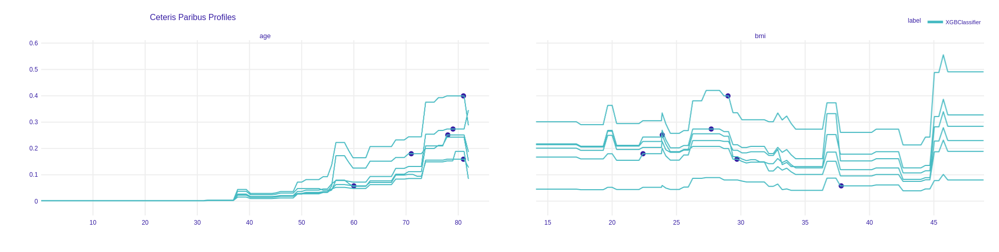

We can clearly see how on those few example increasing an age increases brain stroke prediction.

## Ad. 3
When compared indexes 8 and 15 on CP of avg_glucose_level we can observe that prediction increases in different value range. In one sample it is between 160-190 and in the second between 220 and 250.

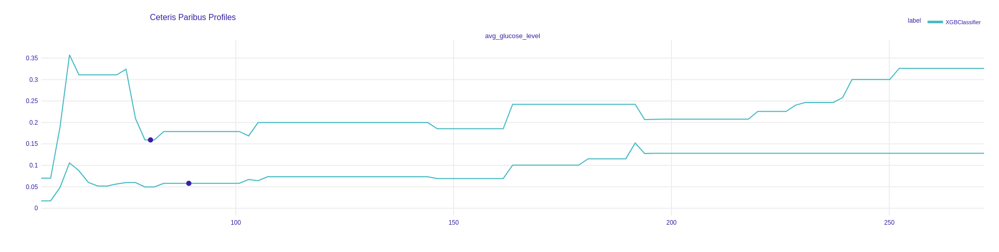

## Ad. 4 
Comparing CP with PDP. Results below:


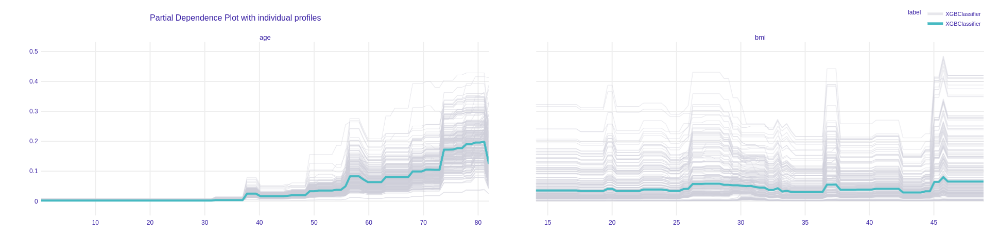

In both *age* and *bmi* PDP plots we observe how blue lines look like the same function as shadows (CP) but shifted. We also observe that *bmi* have very small impact on prediction.

## Ad. 5 Comparing with different models:
In line with the intuition PDP functions for LogisticRegression look like smoothed PDP functions for XGBClassifier.

PDP for XGBClassifier:

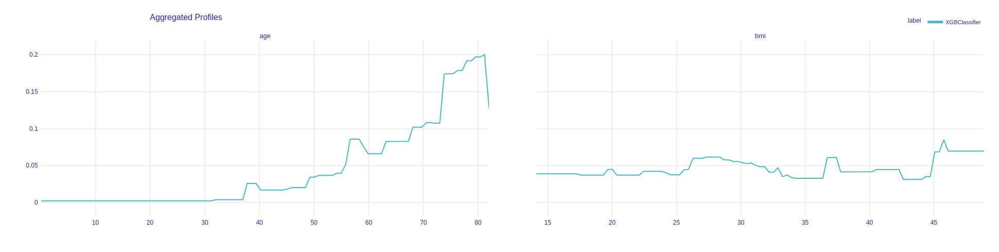

PDP for LogisticRegression:

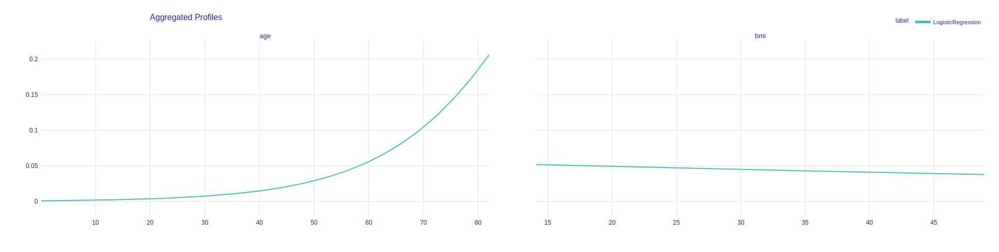

## Ad.6
CP an PDP provides good insight of how attributes contribute to final prediction. 
They seems a good complement to lime and shap methods. First we can indicate which attributes are the most important and then we can vizualize how change in values impacts prediction.

# Appendix

## 0. Setup

In [ ]:
!pip install dalex shap catboost lime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
import pandas as pd
import lime

import dalex as dx
import shap

In [ ]:
df = pd.read_csv("brain_stroke.csv")
df

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
0,Male,67.0,0,1,Yes,Private,Urban,228.69,36.6,formerly smoked,1
1,Male,80.0,0,1,Yes,Private,Rural,105.92,32.5,never smoked,1
2,Female,49.0,0,0,Yes,Private,Urban,171.23,34.4,smokes,1
3,Female,79.0,1,0,Yes,Self-employed,Rural,174.12,24.0,never smoked,1
4,Male,81.0,0,0,Yes,Private,Urban,186.21,29.0,formerly smoked,1
...,...,...,...,...,...,...,...,...,...,...,...
4976,Male,41.0,0,0,No,Private,Rural,70.15,29.8,formerly smoked,0
4977,Male,40.0,0,0,Yes,Private,Urban,191.15,31.1,smokes,0
4978,Female,45.0,1,0,Yes,Govt_job,Rural,95.02,31.8,smokes,0
4979,Male,40.0,0,0,Yes,Private,Rural,83.94,30.0,smokes,0


Dataset consists of features that are nonnumerical. Let's  hot encode them first.

In [ ]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import make_column_transformer


df_one_hot = pd.get_dummies(df, drop_first = True)
df_one_hot

,age,hypertension,heart_disease,avg_glucose_level,bmi,stroke,gender_Male,ever_married_Yes,work_type_Private,work_type_Self-employed,work_type_children,Residence_type_Urban,smoking_status_formerly smoked,smoking_status_never smoked,smoking_status_smokes
0,67.0,0,1,228.69,36.6,1,1,1,1,0,0,1,1,0,0
1,80.0,0,1,105.92,32.5,1,1,1,1,0,0,0,0,1,0
2,49.0,0,0,171.23,34.4,1,0,1,1,0,0,1,0,0,1
3,79.0,1,0,174.12,24.0,1,0,1,0,1,0,0,0,1,0
4,81.0,0,0,186.21,29.0,1,1,1,1,0,0,1,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4976,41.0,0,0,70.15,29.8,0,1,0,1,0,0,0,1,0,0
4977,40.0,0,0,191.15,31.1,0,1,1,1,0,0,1,0,0,1
4978,45.0,1,0,95.02,31.8,0,0,1,0,0,0,0,0,0,1
4979,40.0,0,0,83.94,30.0,0,1,1,1,0,0,0,0,0,1


Preparing train and test samples.

In [ ]:
X = df_one_hot.drop("stroke", axis=1)
y = df_one_hot.stroke
X_train, X_test, y_train, y_test =train_test_split( X, y, test_size=0.2, random_state=42)

In [ ]:
X_train

,age,hypertension,heart_disease,avg_glucose_level,bmi,gender_Male,ever_married_Yes,work_type_Private,work_type_Self-employed,work_type_children,Residence_type_Urban,smoking_status_formerly smoked,smoking_status_never smoked,smoking_status_smokes
1652,26.00,0,0,168.15,22.9,0,0,1,0,0,1,0,1,0
1609,27.00,0,0,80.57,39.8,0,1,1,0,0,1,0,0,1
166,54.00,0,0,87.85,31.1,1,1,0,0,0,0,0,0,1
2488,2.00,0,0,92.30,14.8,0,0,0,0,1,0,0,0,0
3337,69.00,1,0,112.69,33.5,0,1,1,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4426,54.00,0,0,231.54,29.9,0,1,0,0,0,1,0,1,0
466,38.00,0,0,70.92,41.6,0,1,0,0,0,1,0,1,0
3092,13.00,0,0,90.60,16.9,1,0,1,0,0,0,0,1,0
3772,0.48,0,0,118.75,17.4,0,0,0,0,1,0,0,0,0


### 0.1 Training XGBoost classifier model

In [ ]:
xgb=XGBClassifier()
xgb.fit(X_train,y_train)
xgb_predict=xgb.predict(X_test)
xgb_acc=accuracy_score(xgb_predict,y_test)
model = xgb
xgb_acc

0.9458375125376128

The model achieved 94,6% accuracy.

### 1. Calculating the predictions for some selected observations.

In [ ]:
observations = [4, 8, 15, 16, 34, 42]
predictions = model.predict(X_train.iloc[observations])
predictions

array([0, 0, 0, 0, 0, 0])

## 2. Calculating the What-if plots AIX360, Alibi dalex, PDPbox;

In [ ]:
explainer = dx.Explainer(model, X_test, y_test)

Preparation of a new explainer is initiated

  -> data              : 997 rows 14 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 997 values
  -> model_class       : xgboost.sklearn.XGBClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x7f2614c2f830> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.000699, mean = 0.0488, max = 0.491
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.491, mean = 0.00533, max = 0.999
  -> model_info        : package xgboost

A new explainer has been created!


In [ ]:
explainer.model_performance(cutoff=y_train.mean())

,recall,precision,f1,accuracy,auc
XGBClassifier,0.814815,0.140575,0.239782,0.72016,0.836142


In [ ]:
observations_data = X_train.iloc[observations]
explainer.predict(observations_data)

array([0.07293652, 0.00089618, 0.01622023, 0.24037567, 0.04421299,
       0.00316113], dtype=float32)

In [ ]:
explainer.model_parts().result

,variable,dropout_loss,label
0,gender_Male,0.163248,XGBClassifier
1,work_type_Self-employed,0.163655,XGBClassifier
2,_full_model_,0.163858,XGBClassifier
3,work_type_children,0.163858,XGBClassifier
4,Residence_type_Urban,0.163920,XGBClassifier
5,ever_married_Yes,0.164222,XGBClassifier
6,smoking_status_smokes,0.164908,XGBClassifier
7,work_type_Private,0.165424,XGBClassifier
8,smoking_status_formerly smoked,0.165506,XGBClassifier
9,smoking_status_never smoked,0.165930,XGBClassifier


In [ ]:
cp = explainer.predict_profile(new_observation=X.iloc[observations])

Calculating ceteris paribus: 100%|██████████| 14/14 [00:00<00:00, 191.98it/s]


In [ ]:
cp.plot(variables=["age", "bmi"])

In [ ]:
cp.plot(variables=["avg_glucose_level"])

In [ ]:
cp_8_15 = explainer.predict_profile(new_observation=X.iloc[[8,15]])
cp_8_15.plot(variables=["avg_glucose_level"])

Calculating ceteris paribus: 100%|██████████| 14/14 [00:00<00:00, 167.49it/s]


### 3. Finding two observations in the data set, such that they have different CP profiles

### 4. Comparing CP with PDP

In [ ]:
pdp = explainer.model_profile() 

Calculating ceteris paribus: 100%|██████████| 14/14 [00:01<00:00, 11.15it/s]


In [ ]:
pdp.result

,_vname_,_label_,_x_,_yhat_,_ids_
0,age,XGBClassifier,0.0800,0.002205,0
1,age,XGBClassifier,0.8992,0.002205,0
2,age,XGBClassifier,1.7184,0.002205,0
3,age,XGBClassifier,2.5376,0.002205,0
4,age,XGBClassifier,3.3568,0.002205,0
...,...,...,...,...,...
1409,smoking_status_smokes,XGBClassifier,0.9600,0.050645,0
1410,smoking_status_smokes,XGBClassifier,0.9700,0.050645,0
1411,smoking_status_smokes,XGBClassifier,0.9800,0.050645,0
1412,smoking_status_smokes,XGBClassifier,0.9900,0.050645,0


In [ ]:
pdp.plot(variables=["age", "bmi"])

In [ ]:
pdp.plot(variables=["age", "bmi"], geom="profiles", title="Partial Dependence Plot with individual profiles")

### 5.2 LogisticRegression

In [ ]:
clf=LogisticRegression()
clf.fit(X_train,y_train)
clf_predict=xgb.predict(X_test)
clf_acc=accuracy_score(clf_predict,y_test)
model = clf
clf_acc

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



0.9458375125376128

In [ ]:
explainer = dx.Explainer(model, X_test, y_test)
explainer.model_performance(cutoff=y_train.mean())

Preparation of a new explainer is initiated

  -> data              : 997 rows 14 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 997 values
  -> model_class       : sklearn.linear_model._logistic.LogisticRegression (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x7f2614c2f830> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.000218, mean = 0.0484, max = 0.394
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.353, mean = 0.00578, max = 1.0
  -> model_info        : package sklearn

A new explainer has been created!


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but LogisticRegression was fitted with feature names



,recall,precision,f1,accuracy,auc
LogisticRegression,0.814815,0.138801,0.237197,0.716148,0.836672


In [ ]:
observations_data = X_train.iloc[observations]
explainer.predict(observations_data)

array([0.13118459, 0.01077764, 0.02594454, 0.08462255, 0.03876212,
       0.01350558])

In [ ]:
pdp_lr = explainer.model_profile() 

Calculating ceteris paribus: 100%|██████████| 14/14 [00:00<00:00, 32.75it/s]


In [ ]:
pdp_lr.plot(variables=["age", "bmi"])